# Guidelines

In [1]:
# Etude de faisabilité d'un moteur de classification d'articles basé sur une image et une description 
# pour l'automatisation de l'attribution de la catégorie de l'article,

# 1- Prétraitement des images et des descriptions des produits,
# 2- Une réduction de dimension,
# 3- Puis un clustering:
# Les résultats du clustering -> représentation en deux dimensions à déterminer, illustre que les caractéristiques 
# extraites permettent de regrouper des produits de même catégorie,

# 4- Représentation graphique 
# Attention, Linda n’a pas besoin d’un moteur de classification à ce stade, mais bien d’une étude de faisabilité !

# Extraire les features : SIFT / ORB / SURF,
# CNN Transfer Learning peut être utilisé en complément 

# Imports

In [14]:
%reload_ext autoreload
%autoreload 2

import os
import re
import math
import warnings
import missingno as msno
import numpy as np
import pandas as pd
import seaborn as sns
import folium
import datetime
import nltk
import gensim
import pyLDAvis 
import imp 
import cv2
import tensorflow as tf
import plotly.express as px
from pyLDAvis import sklearn
from matplotlib import pyplot as plt
from pandas_profiling import ProfileReport
from datetime import datetime
from folium import IFrame
from PIL import Image, ImageOps, ImageFilter
from collections import defaultdict, Counter
#from xgboost import XGBoostRegressor
from keras import Model
import tensorflow.experimental.numpy as tnp
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.preprocessing.image import load_img, img_to_array
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import decode_predictions
from keras.applications.vgg16 import VGG16
from keras.layers import Dense, Flatten
from tensorflow.keras.optimizers import SGD
from geopy.geocoders import Nominatim
from folium.plugins import HeatMap
from mpl_toolkits.mplot3d import Axes3D
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import PorterStemmer, WordNetLemmatizer
from nltk.classify import NaiveBayesClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, plot_confusion_matrix
from sklearn.decomposition import PCA, LatentDirichletAllocation
from sklearn.compose import ColumnTransformer, TransformedTargetRegressor, make_column_selector
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder, QuantileTransformer, RobustScaler, MinMaxScaler, normalize
from sklearn.naive_bayes import MultinomialNB, ComplementNB, CategoricalNB
from sklearn.manifold import TSNE
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering, Birch
from sklearn.impute import SimpleImputer
from scipy.sparse import coo_matrix, csr_matrix 

#
from P6_04_utils import *
#
pd.options.mode.chained_assignment = None  # default='warn'
#
%matplotlib inline
#
pd.set_option("display.max_columns", None)
pd.set_option('display.max_colwidth', 100)
#
warnings.filterwarnings('ignore')
# Setting theme
sns.set_theme(style="white")
#
#nltk.download('wordnet')
#
#%reload_ext pycodestyle_magic
#%flake8_on
#%flake8_off

# Download 

In [15]:
# Check .csv file size
files_list = ["data/flipkart_com-ecommerce_sample_1050.csv"]

for file in files_list:
    print(file + ": " + str(os.stat(file).st_size / 2**30) + ' Go')


data/flipkart_com-ecommerce_sample_1050.csv: 0.0015896949917078018 Go


In [16]:
# Import and convert .csv files into pandas dataframes
df = pd.read_csv(r"data/flipkart_com-ecommerce_sample_1050.csv",
                 sep=",",
                 encoding="utf-8")


# Data

In [17]:
info(df)
df.head()

15 columns
1050 rows
Rate of missing values in df : 2.165079365079365 %



,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-multicolor-abstract-eyelet-door-curtain/p/itmeg7bkzdg...,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,"[""Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstrac...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,"Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegan...",No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""value""=>""Elegance""}, {""key""=>""Designed For"", ""value..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-towel/p/itmegfzhxbyucwgn?pid=BTWEGFZHGBXPHZUH,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath Towels >> Sathiyas Baby Bath Towels >> Sathiyas Cot...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,"Specifications of Sathiyas Cotton Bath Towel (3 Bath Towel, Red, Yellow, Blue) Bath Towel Featur...",No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Washable"", ""value""=>""Yes""}, {""key""=>""Material"", ""val..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-face-towel-set/p/itmeg6shbrpubhca?pid=BTWEG6SHXTDB2A2Y,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath Towels >> Eurospa Baby Bath Towels >> Eurospa Cotto...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,"Key Features of Eurospa Cotton Terry Face Towel Set Size: small Height: 9 inch GSM: 360,Eurospa ...",No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"", ""value""=>""Cotton Terry""}, {""key""=>""Design"", ""valu..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-cotton-printed-king-sized-double-bedsheet/p/itmejt...,SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet,"[""Home Furnishing >> Bed Linen >> Bedsheets >> SANTOSH ROYAL FASHION Bedsheets >> SANTOSH ROYAL ...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet Royal Bedsheet P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""value""=>""SANTOSH ROYAL FASHION""}, {""key""=>""Machine ..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-floral-king-sized-double-bedsheet/p/itmejthnwahrnt7v...,Jaipur Print Cotton Floral King sized Double Bedsheet,"[""Home Furnishing >> Bed Linen >> Bedsheets >> Jaipur Print Bedsheets >> Jaipur Print Cotton Flo...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,"Key Features of Jaipur Print Cotton Floral King sized Double Bedsheet 100% cotton,Jaipur Print C...",No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Washable"", ""value""=>""Yes""}, {""key""=>""Brand"", ""value""..."


In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

In [19]:
df.describe(include='all')

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
count,1050,1050,1050,1050,1050,1050,1049.000000,1049.000000,1050,1050,1050,1050,1050,712,1049
unique,1050,149,1050,1050,642,1050,NaN,NaN,1050,2,1050,27,27,490,984
top,5cd3d274d71e1e0d6bf075421461b2d5,2015-12-01 12:40:44 +0000,http://www.flipkart.com/pristine-hard-anodised-kadhai-2-l/p/itme7ffj4ppqnvrt?pid=PTPE7FFJTHJDMDB5,Unravel India Showpiece - 16 cm,"[""Home Furnishing >> Bed Linen >> Blankets, Quilts & Dohars""]",BLAEEH2ZJ3G9DA7G,NaN,NaN,893aa5ed55f7cff2eccea7758d7a86bd.jpg,False,"MSenterprises Floral Cushions Cover (Pack of 5, 40 cm*40 cm, Brown)\r\n ...",No rating available,No rating available,PRINT SHAPES,"{""product_specification""=>[{""key""=>""Type"", ""value""=>""Mug""}, {""key""=>""Mug Capacity"", ""value""=>""5...."
freq,1,150,1,1,56,1,NaN,NaN,1,993,1,889,889,11,22
mean,NaN,NaN,NaN,NaN,NaN,NaN,2186.197331,1584.527169,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,7639.229411,7475.099680,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,35.000000,35.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,555.000000,340.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,999.000000,600.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,1999.000000,1199.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<AxesSubplot:>

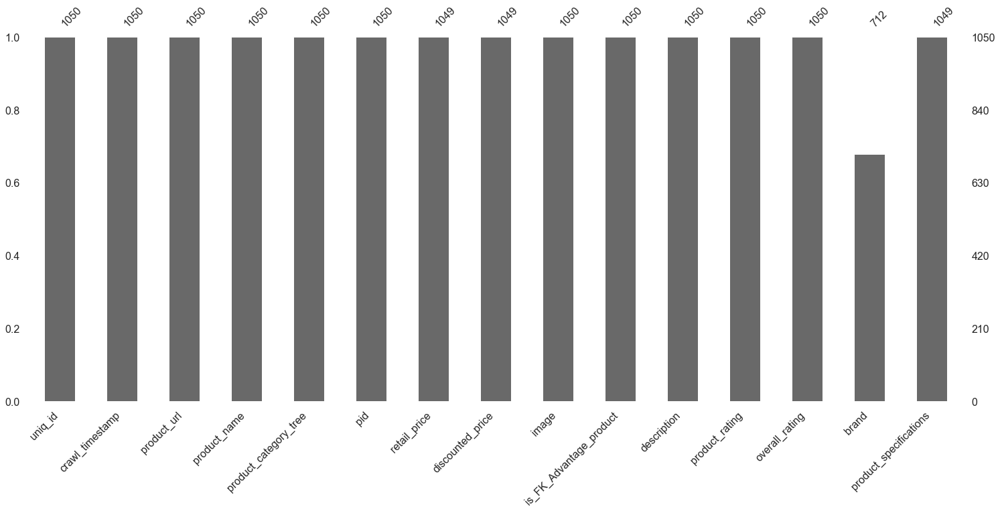

In [20]:
msno.bar(df)

In [21]:
# pandas_profiling
profile = ProfileReport(df, title="")
profile.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# df_image

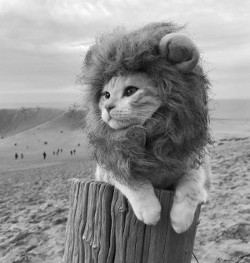

In [55]:
# Charger l'image
img = Image.open("test/simba.png")
img

Largeur : 250 px, hauteur : 263 px
Format des pixels : L
Taille de la matrice de pixels : (263, 250)


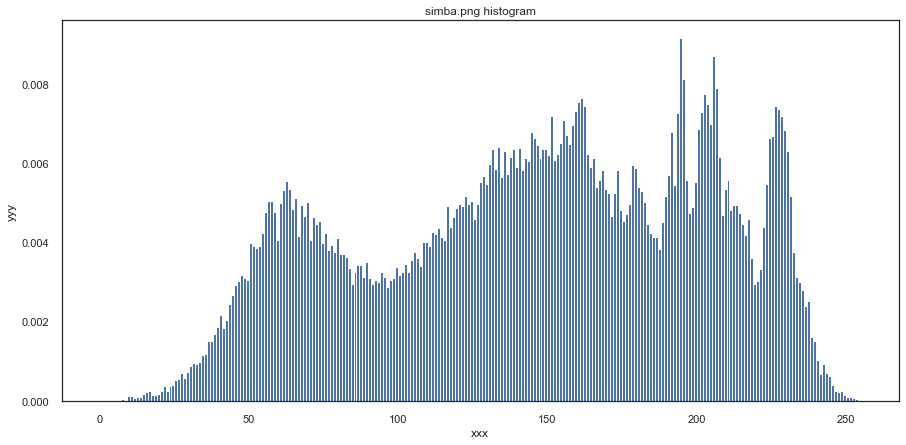

In [59]:
#
mat = np.array(img)

# Params
image_params_function(img)

# generate and display histogram
display_histogramm(mat, 
                   256, 
                   True, 
                   False,  
                   "xxx", 
                   "yyy", 
                   "simba.png histogram")


## Sandbox (Preprocessing)

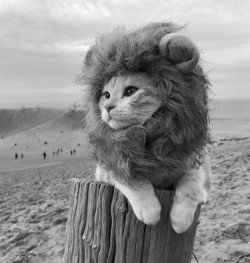

In [60]:
# Modify exposition
img_ac = ImageOps.autocontrast(img)
img_ac

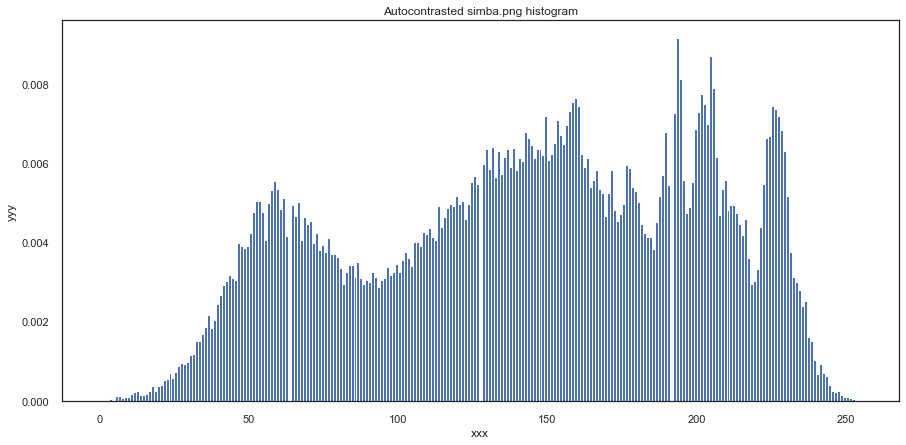

In [61]:
#
mat_ac = np.array(img_ac)

# generate and display histogram
display_histogramm(mat_ac, 
                   256, 
                   True, 
                   False,  
                   "xxx", 
                   "yyy", 
                   "Autocontrasted simba.png histogram")


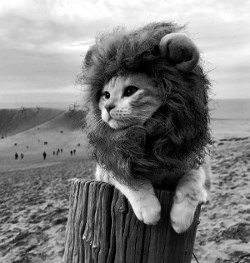

In [41]:
# Modify contrast
img_equalize = ImageOps.equalize(img)
img_equalize

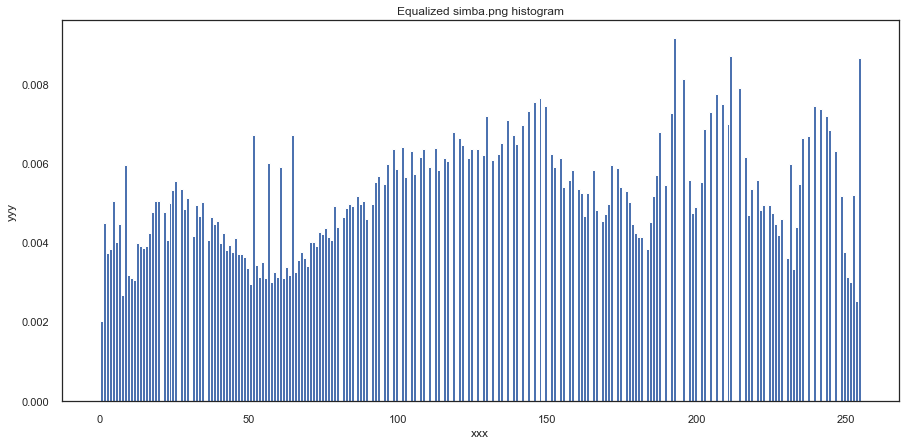

In [65]:
#
mat_equalize = np.array(img_equalize)

# generate and display histogram
display_histogramm(mat_equalize, 
                   256, 
                   True, 
                   False,  
                   "xxx", 
                   "yyy", 
                   "Equalized simba.png histogram")


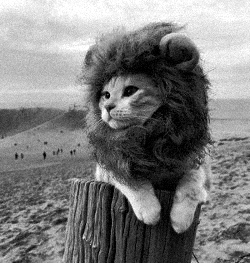

In [56]:
# Créer l'image bruitée
noise = np.random.normal(0, 7, mat_equalize.shape)
img_noisy = Image.fromarray(mat_equalize + noise).convert('L')
img_noisy

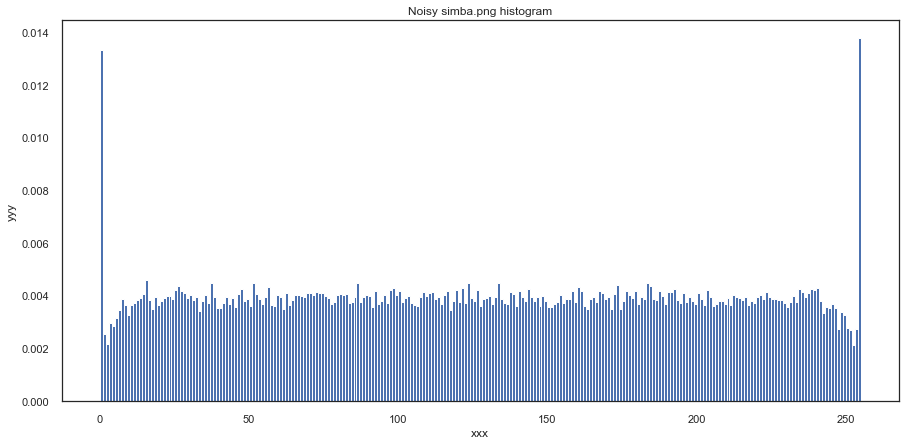

In [57]:
#
mat_noisy = np.array(img_noisy)
   
# generate and display histogram
display_histogramm(mat_noisy, 
                   256, 
                   True, 
                   False,  
                   "xxx", 
                   "yyy", 
                   "Noisy simba.png histogram")

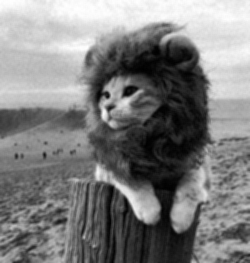

In [58]:
# Appliquer le lissage par moyennage
img_filtered = img_noisy.filter(ImageFilter.BoxBlur(1))
img_filtered

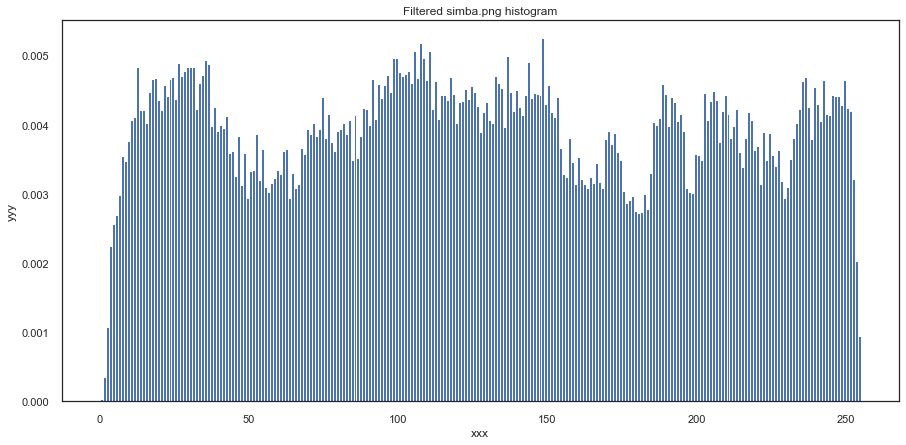

In [64]:
#
mat_filtered = np.array(img_filtered)

# generate and display histogram
display_histogramm(mat_filtered, 
                   256, 
                   True, 
                   False,  
                   "xxx", 
                   "yyy", 
                   "Filtered simba.png histogram")



## Product category treatment

In [20]:
#
df_image = df[['product_name', 
                'product_category_tree', 
                'image', ]]

# Overview
info(df_image)
df_image.head()

3 columns
1050 rows
Rate of missing values in df : 0.0 %



,product_name,product_category_tree,image
0,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,"[""Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstrac...",55b85ea15a1536d46b7190ad6fff8ce7.jpg
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath Towels >> Sathiyas Baby Bath Towels >> Sathiyas Cot...",7b72c92c2f6c40268628ec5f14c6d590.jpg
2,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath Towels >> Eurospa Baby Bath Towels >> Eurospa Cotto...",64d5d4a258243731dc7bbb1eef49ad74.jpg
3,SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet,"[""Home Furnishing >> Bed Linen >> Bedsheets >> SANTOSH ROYAL FASHION Bedsheets >> SANTOSH ROYAL ...",d4684dcdc759dd9cdf41504698d737d8.jpg
4,Jaipur Print Cotton Floral King sized Double Bedsheet,"[""Home Furnishing >> Bed Linen >> Bedsheets >> Jaipur Print Bedsheets >> Jaipur Print Cotton Flo...",6325b6870c54cd47be6ebfbffa620ec7.jpg


In [21]:
#
df_image = prepare_category_column_function(df_image, 'product_category_tree', 3)

#
df_image = select_category_depth_function(df_image, 1)

# Overview
info(df_image)
df_image.head()


Unique categories at level 1: 7

4 columns
1050 rows
Rate of missing values in df : 0.0 %



,product_name,product_category_tree,image,product_category
0,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,"[""Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstrac...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath Towels >> Sathiyas Baby Bath Towels >> Sathiyas Cot...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath Towels >> Eurospa Baby Bath Towels >> Eurospa Cotto...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care
3,SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet,"[""Home Furnishing >> Bed Linen >> Bedsheets >> SANTOSH ROYAL FASHION Bedsheets >> SANTOSH ROYAL ...",d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing
4,Jaipur Print Cotton Floral King sized Double Bedsheet,"[""Home Furnishing >> Bed Linen >> Bedsheets >> Jaipur Print Bedsheets >> Jaipur Print Cotton Flo...",6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing


<AxesSubplot:>

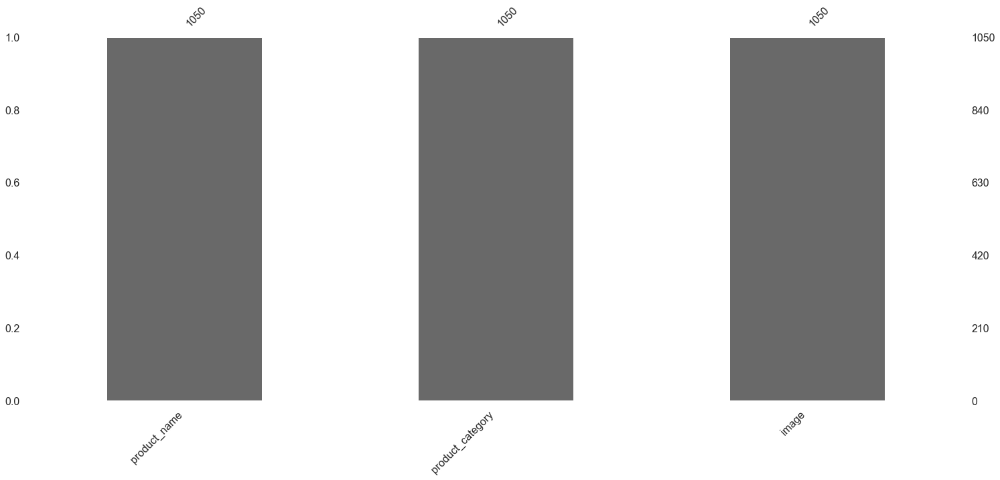

In [22]:
df_image = df_image[['product_name','product_category','image']]

msno.bar(df_image)

In [24]:
#
df_image = image_details_function(df_image, 'image')

# Overview
info(df_image)
df_image.head()

6 columns
1050 rows
Rate of missing values in df : 0.0 %



,product_name,product_category,image,image_thumbnail,image_array,image_size
0,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,Home Furnishing,55b85ea15a1536d46b7190ad6fff8ce7.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=3600x3600 at 0x1D2689CD220>,"[[[192, 184, 173], [192, 184, 173], [193, 185, 174], [193, 185, 174], [193, 185, 174], [192, 184...","(3600, 3600, 3)"
1,Sathiyas Cotton Bath Towel,Baby Care,7b72c92c2f6c40268628ec5f14c6d590.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2388x1293 at 0x1D2683EB340>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(1293, 2388, 3)"
2,Eurospa Cotton Terry Face Towel Set,Baby Care,64d5d4a258243731dc7bbb1eef49ad74.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=982x729 at 0x1D2683EB970>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(729, 982, 3)"
3,SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet,Home Furnishing,d4684dcdc759dd9cdf41504698d737d8.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1100x831 at 0x1D268600FA0>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(831, 1100, 3)"
4,Jaipur Print Cotton Floral King sized Double Bedsheet,Home Furnishing,6325b6870c54cd47be6ebfbffa620ec7.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2670x2088 at 0x1D2685DE130>,"[[[99, 99, 91], [80, 80, 72], [67, 67, 57], [62, 62, 52], [72, 69, 60], [83, 80, 73], [85, 82, 7...","(2088, 2670, 3)"


## SIFT

### Sandbox 1

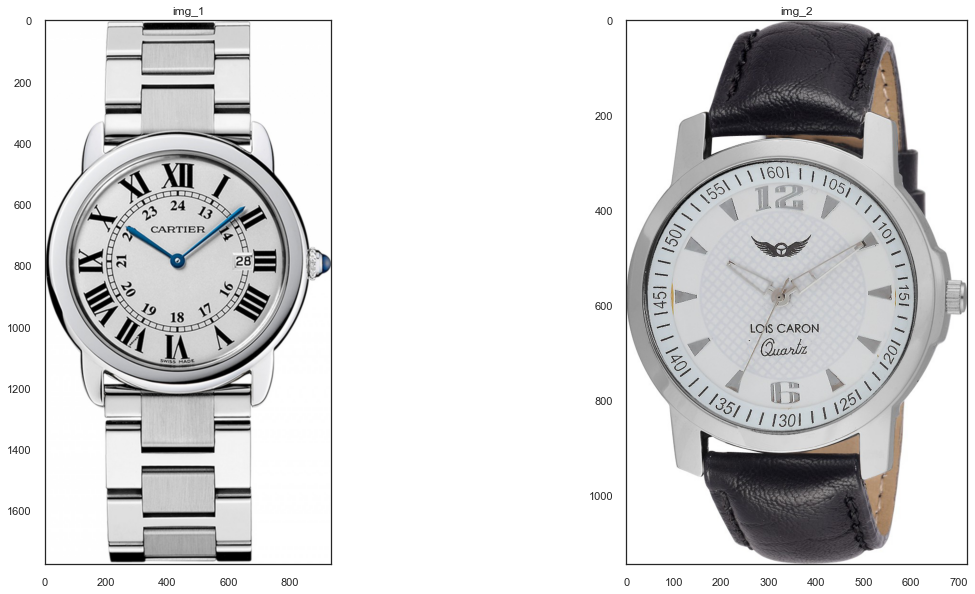

In [25]:
# read image
img_1 = df_image['image_array'][11]
img_2 = df_image['image_array'][12]

# Display image with and without keypoints size
display_both(img_1, 
             None, 
             "img_1", 
             img_2, 
             None, 
             "img_2")


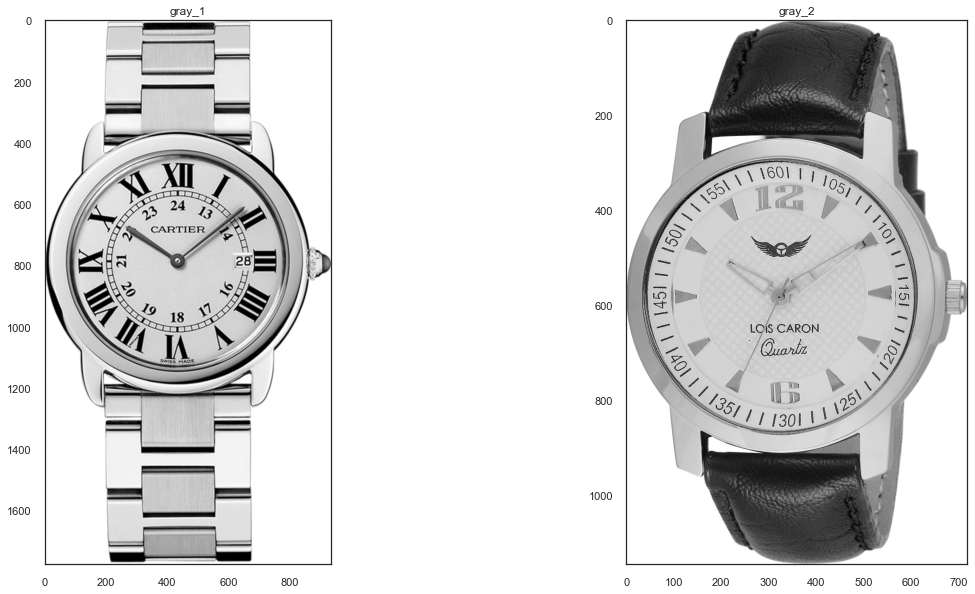

In [26]:
# change color to gray for both images
gray_1 = cv2.cvtColor(img_1, cv2.COLOR_BGR2GRAY)
gray_2 = cv2.cvtColor(img_2, cv2.COLOR_BGR2GRAY)

# resize
#gray_1 = cv2.resize(gray_1, (300,300))
#gray_2 = cv2.resize(gray_2, (300,300))

# Display image with and without keypoints size
display_both(gray_1, 
             'gray', 
             "gray_1", 
             gray_2, 
             'gray', 
             "gray_2")


In [27]:
#sift
#
sift = cv2.SIFT_create()

#
keypoints_1, descriptors_1 = sift.detectAndCompute(gray_1, None)
keypoints_2, descriptors_2 = sift.detectAndCompute(gray_2, None)

#
len(keypoints_1), len(keypoints_2)

(2997, 2521)

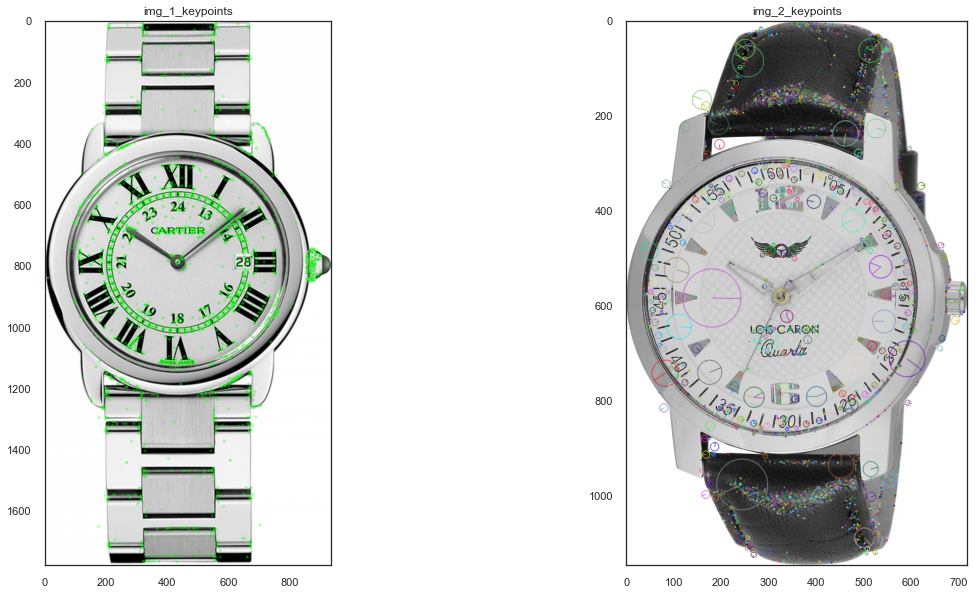

In [28]:
#keypoints
img_1_keypoints = cv2.drawKeypoints(gray_1, 
                                    keypoints_1, 
                                    img_1,
                                    color = (0, 255, 0))
img_2_keypoints = cv2.drawKeypoints(gray_2, 
                                    keypoints_2, 
                                    img_2,
                                    flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Display image with and without keypoints size
display_both(img_1_keypoints, 
             None, 
             "img_1_keypoints", 
             img_2_keypoints, 
             None,  
             "img_2_keypoints")


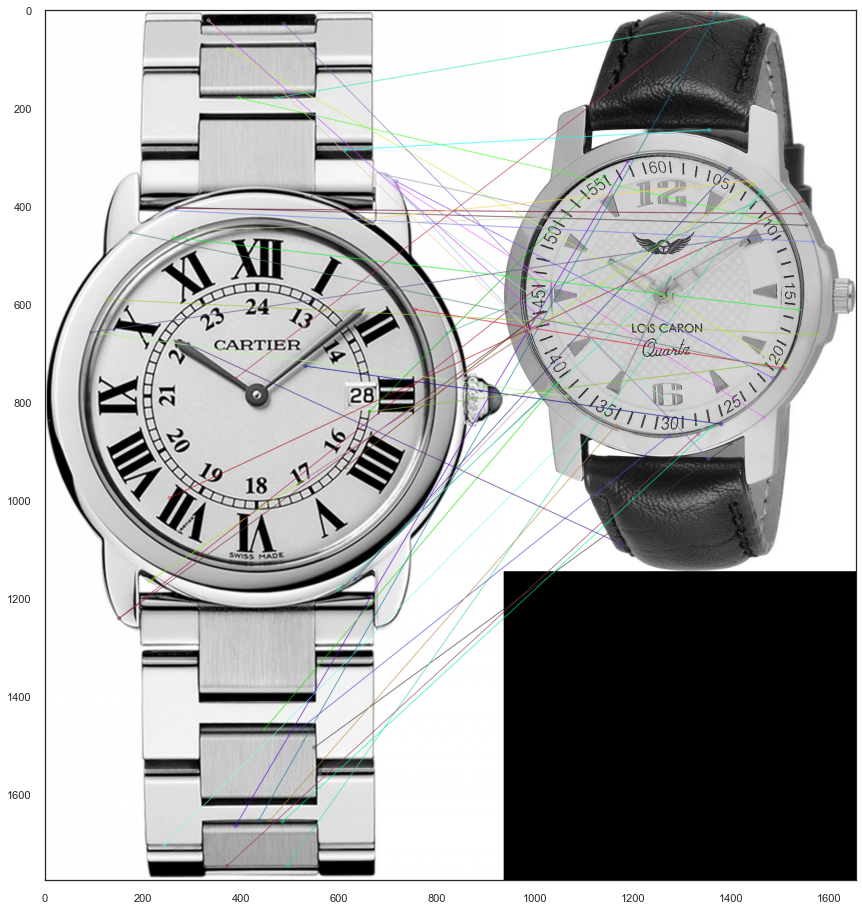

In [29]:
#feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

matches = bf.match(descriptors_1, descriptors_2)
matches = sorted(matches, key = lambda x: x.distance)

img_1_2_matching = cv2.drawMatches(gray_1, 
                                   keypoints_1, 
                                   gray_2, 
                                   keypoints_2, 
                                   matches[:50], 
                                   gray_2, 
                                   flags=2)


plt.figure(figsize=(16,16))

plt.imshow(img_1_2_matching)
plt.show()

### Sandbox 2

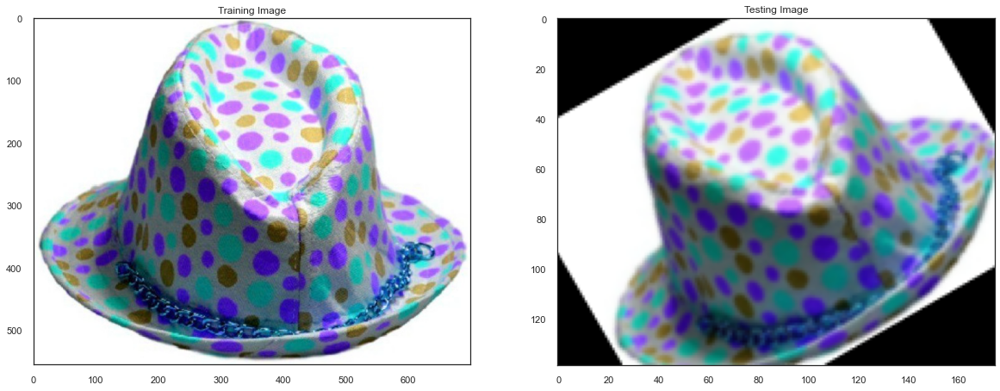

In [30]:
# Load the image
image1 = df_image['image_array'][666]

# Convert the training 
training_image = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)
training_gray = cv2.cvtColor(training_image, cv2.COLOR_RGB2GRAY)

# resize
#training_image = cv2.resize(training_image, (300,300))
#training_gray = cv2.resize(training_gray, (300,300))

# Create test image by adding Scale Invariance and Rotational Invariance
test_image = cv2.pyrDown(training_image)
test_image = cv2.pyrDown(test_image)
num_rows, num_cols = test_image.shape[:2]

rotation_matrix = cv2.getRotationMatrix2D((num_cols/2, num_rows/2), 
                                          30, 
                                          1)

#
test_image = cv2.warpAffine(test_image, 
                            rotation_matrix, 
                            (num_cols, num_rows))
test_gray = cv2.cvtColor(test_image, 
                         cv2.COLOR_RGB2GRAY)

# Display traning image and testing image
display_both(training_image, 
             None, 
             "Training Image", 
             test_image, 
             None,  
             "Testing Image")



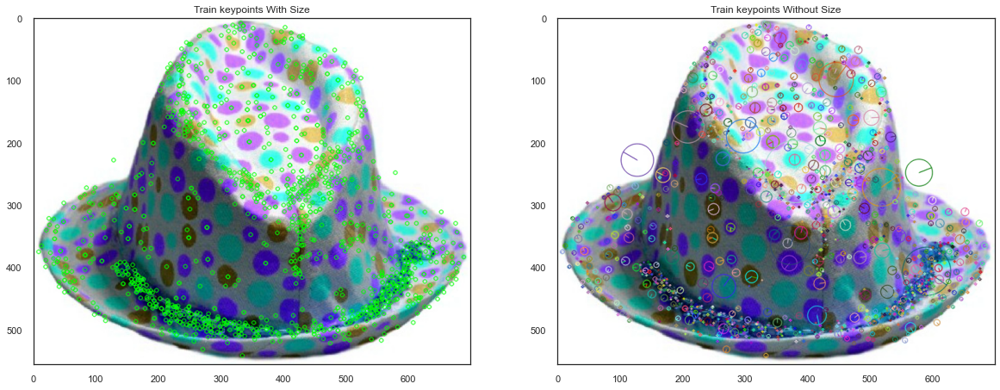


Number of Keypoints Detected In The Training Image:  1295
Number of Keypoints Detected In The Query Image: 327


In [31]:
sift = cv2.SIFT_create()

train_keypoints, train_descriptor = sift.detectAndCompute(training_gray, None)
test_keypoints, test_descriptor = sift.detectAndCompute(test_gray, None)

keypoints_without_size = np.copy(training_image)
keypoints_with_size = np.copy(training_image)

cv2.drawKeypoints(training_image, 
                  train_keypoints, 
                  keypoints_without_size, 
                  color = (0, 255, 0))
cv2.drawKeypoints(training_image, 
                  train_keypoints, 
                  keypoints_with_size, 
                  flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)


# Display image with and without keypoints size
display_both(keypoints_without_size, 
             None, 
             "Train keypoints With Size", 
             keypoints_with_size, 
             None, 
             "Train keypoints Without Size")


# Print the number of keypoints detected 
# in the training image
print('\n' + "Number of Keypoints Detected In The Training Image: ", len(train_keypoints))
# in the query image
print("Number of Keypoints Detected In The Query Image: " + str(len(test_keypoints)))

Number of Matching Keypoints Between The Training and Query Images: 1295



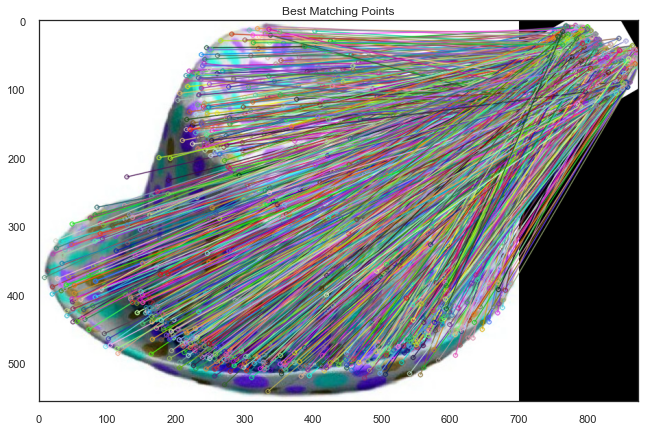

In [32]:
# Create a Brute Force Matcher object.
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck = False)

# Perform the matching between the SIFT descriptors of the training image and the test image
matches = bf.match(train_descriptor, test_descriptor)
matches = sorted(matches, key = lambda x : x.distance)
# Print total number of matching points between the training and query images
print("Number of Matching Keypoints Between The Training and Query Images: " + str(len(matches)) + "\n")

#
result = cv2.drawMatches(training_image, 
                         train_keypoints, 
                         test_gray, 
                         test_keypoints, 
                         matches, 
                         test_gray, 
                         flags = 2)

# Display the best matching points
plt.rcParams['figure.figsize'] = [14.0, 7.0]
plt.title('Best Matching Points')
plt.imshow(result)
plt.show()



### Preprocessing


In [33]:
#
df_image_preprocessed = df_image.copy()

# Overview
df_image_preprocessed.head()

,product_name,product_category,image,image_thumbnail,image_array,image_size
0,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,Home Furnishing,55b85ea15a1536d46b7190ad6fff8ce7.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=3600x3600 at 0x1D2689CD220>,"[[[192, 184, 173], [192, 184, 173], [193, 185, 174], [193, 185, 174], [193, 185, 174], [192, 184...","(3600, 3600, 3)"
1,Sathiyas Cotton Bath Towel,Baby Care,7b72c92c2f6c40268628ec5f14c6d590.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2388x1293 at 0x1D2683EB340>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(1293, 2388, 3)"
2,Eurospa Cotton Terry Face Towel Set,Baby Care,64d5d4a258243731dc7bbb1eef49ad74.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=982x729 at 0x1D2683EB970>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(729, 982, 3)"
3,SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet,Home Furnishing,d4684dcdc759dd9cdf41504698d737d8.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1100x831 at 0x1D268600FA0>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(831, 1100, 3)"
4,Jaipur Print Cotton Floral King sized Double Bedsheet,Home Furnishing,6325b6870c54cd47be6ebfbffa620ec7.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2670x2088 at 0x1D2685DE130>,"[[[99, 99, 91], [80, 80, 72], [67, 67, 57], [62, 62, 52], [72, 69, 60], [83, 80, 73], [85, 82, 7...","(2088, 2670, 3)"


In [34]:
# change color and size
df_image_preprocessed = image_preprocessing(df_image_preprocessed, 'image_thumbnail', 'COLOR_BGR2RGB', 224, 224)

# Overview
info(df_image_preprocessed)
df_image_preprocessed.head()


9 columns
1050 rows
Rate of missing values in df : 0.0 %



,product_name,product_category,image,image_thumbnail,image_array,image_size,image_array_preprocessed,image_array_preprocessed_size,image_thumbnail_preprocessed
0,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,Home Furnishing,55b85ea15a1536d46b7190ad6fff8ce7.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=3600x3600 at 0x1D2689CD220>,"[[[192, 184, 173], [192, 184, 173], [193, 185, 174], [193, 185, 174], [193, 185, 174], [192, 184...","(3600, 3600, 3)","[[[146, 111, 102], [120, 123, 75], [108, 106, 106], [126, 132, 126], [131, 120, 91], [112, 123, ...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D206B66C10>
1,Sathiyas Cotton Bath Towel,Baby Care,7b72c92c2f6c40268628ec5f14c6d590.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2388x1293 at 0x1D2683EB340>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(1293, 2388, 3)","[[[124, 108, 103], [131, 130, 98], [101, 106, 110], [144, 93, 153], [96, 138, 123], [103, 157, 8...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D206B66BB0>
2,Eurospa Cotton Terry Face Towel Set,Baby Care,64d5d4a258243731dc7bbb1eef49ad74.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=982x729 at 0x1D2683EB970>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(729, 982, 3)","[[[116, 144, 82], [111, 161, 86], [117, 115, 93], [149, 130, 130], [144, 127, 128], [114, 114, 1...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D20A197B20>
3,SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet,Home Furnishing,d4684dcdc759dd9cdf41504698d737d8.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1100x831 at 0x1D268600FA0>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(831, 1100, 3)","[[[105, 103, 98], [162, 120, 93], [136, 127, 99], [81, 84, 96], [83, 97, 120], [129, 128, 143], ...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D20A1972B0>
4,Jaipur Print Cotton Floral King sized Double Bedsheet,Home Furnishing,6325b6870c54cd47be6ebfbffa620ec7.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2670x2088 at 0x1D2685DE130>,"[[[99, 99, 91], [80, 80, 72], [67, 67, 57], [62, 62, 52], [72, 69, 60], [83, 80, 73], [85, 82, 7...","(2088, 2670, 3)","[[[127, 122, 135], [93, 130, 163], [106, 64, 105], [116, 104, 136], [124, 98, 83], [106, 123, 12...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D20A197760>


### Keypoints and descriptors

In [35]:
#
df_image_preprocessed_detect = keypoint_and_descriptor_function(df_image_preprocessed, 'image_array_preprocessed')

# Overview
info(df_image_preprocessed_detect)
df_image_preprocessed_detect.head()


12 columns
1050 rows
Rate of missing values in df : 0.15873015873015875 %



,product_name,product_category,image,image_thumbnail,image_array,image_size,image_array_preprocessed,image_array_preprocessed_size,image_thumbnail_preprocessed,keypoints,keypoints_number,descriptors
0,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,Home Furnishing,55b85ea15a1536d46b7190ad6fff8ce7.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=3600x3600 at 0x1D2689CD220>,"[[[192, 184, 173], [192, 184, 173], [193, 185, 174], [193, 185, 174], [193, 185, 174], [192, 184...","(3600, 3600, 3)","[[[146, 111, 102], [120, 123, 75], [108, 106, 106], [126, 132, 126], [131, 120, 91], [112, 123, ...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D206B66C10>,"(<KeyPoint 000001D2689CD3C0>, <KeyPoint 000001D2144FB120>, <KeyPoint 000001D2144FB2D0>, <KeyPoin...",6,"[[28.0, 10.0, 40.0, 32.0, 5.0, 6.0, 16.0, 46.0, 29.0, 13.0, 7.0, 2.0, 1.0, 54.0, 79.0, 39.0, 19...."
1,Sathiyas Cotton Bath Towel,Baby Care,7b72c92c2f6c40268628ec5f14c6d590.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2388x1293 at 0x1D2683EB340>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(1293, 2388, 3)","[[[124, 108, 103], [131, 130, 98], [101, 106, 110], [144, 93, 153], [96, 138, 123], [103, 157, 8...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D206B66BB0>,"(<KeyPoint 000001D2144FB390>, <KeyPoint 000001D2144FB570>, <KeyPoint 000001D2144FB630>, <KeyPoin...",5,"[[78.0, 33.0, 19.0, 5.0, 6.0, 11.0, 12.0, 55.0, 12.0, 16.0, 24.0, 92.0, 100.0, 52.0, 13.0, 12.0,..."
2,Eurospa Cotton Terry Face Towel Set,Baby Care,64d5d4a258243731dc7bbb1eef49ad74.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=982x729 at 0x1D2683EB970>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(729, 982, 3)","[[[116, 144, 82], [111, 161, 86], [117, 115, 93], [149, 130, 130], [144, 127, 128], [114, 114, 1...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D20A197B20>,"(<KeyPoint 000001D2144FB6C0>, <KeyPoint 000001D2144FB6F0>, <KeyPoint 000001D2144FB4E0>, <KeyPoin...",7,"[[8.0, 22.0, 33.0, 20.0, 20.0, 25.0, 40.0, 22.0, 6.0, 23.0, 41.0, 40.0, 19.0, 32.0, 48.0, 5.0, 2..."
3,SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet,Home Furnishing,d4684dcdc759dd9cdf41504698d737d8.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1100x831 at 0x1D268600FA0>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(831, 1100, 3)","[[[105, 103, 98], [162, 120, 93], [136, 127, 99], [81, 84, 96], [83, 97, 120], [129, 128, 143], ...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D20A1972B0>,"(<KeyPoint 000001D2144FB810>, <KeyPoint 000001D2144FB720>, <KeyPoint 000001D2144FB7E0>, <KeyPoin...",4,"[[38.0, 7.0, 8.0, 22.0, 16.0, 14.0, 23.0, 70.0, 17.0, 17.0, 8.0, 10.0, 16.0, 24.0, 61.0, 39.0, 1..."
4,Jaipur Print Cotton Floral King sized Double Bedsheet,Home Furnishing,6325b6870c54cd47be6ebfbffa620ec7.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2670x2088 at 0x1D2685DE130>,"[[[99, 99, 91], [80, 80, 72], [67, 67, 57], [62, 62, 52], [72, 69, 60], [83, 80, 73], [85, 82, 7...","(2088, 2670, 3)","[[[127, 122, 135], [93, 130, 163], [106, 64, 105], [116, 104, 136], [124, 98, 83], [106, 123, 12...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D20A197760>,"(<KeyPoint 000001D2144FB780>, <KeyPoint 000001D2144FB480>, <KeyPoint 000001D2144FB7B0>, <KeyPoin...",7,"[[17.0, 13.0, 17.0, 27.0, 6.0, 2.0, 4.0, 24.0, 38.0, 65.0, 26.0, 37.0, 12.0, 22.0, 42.0, 35.0, 3..."


### Clustering

#### 2D



PCA:

(PCA) explained variance for 50 components: 0.8900702024329553



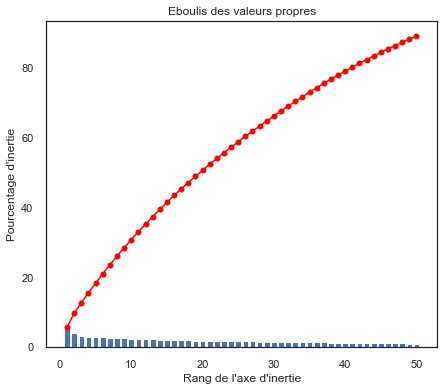



Clustering:



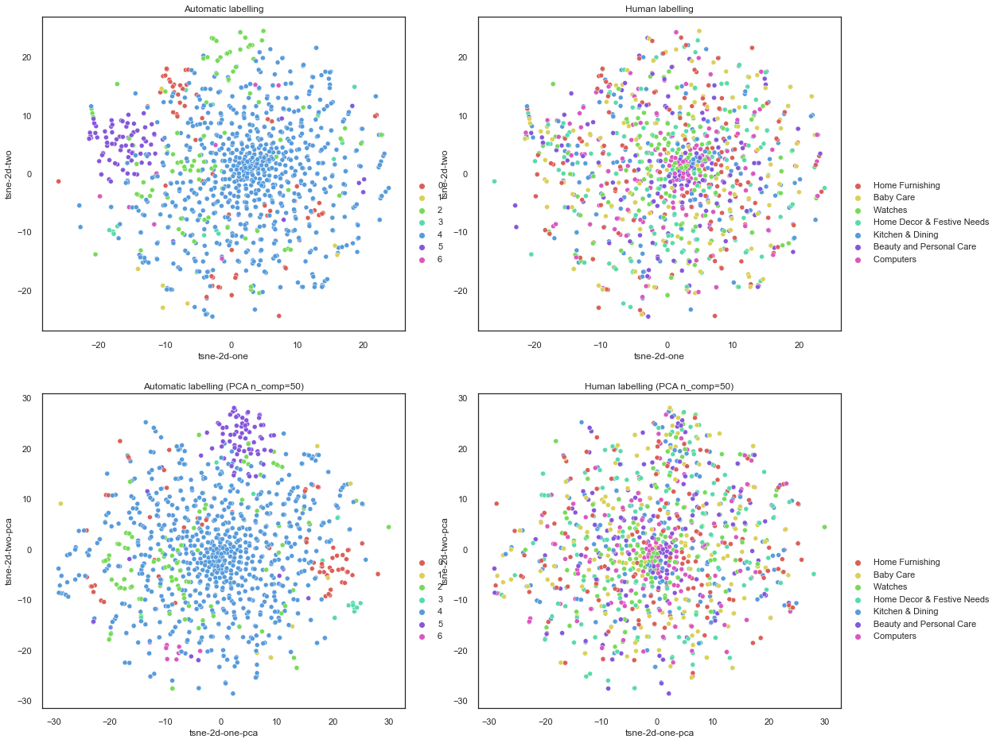


clustering stats:

ARI: 0.0009408339659275323
Silhouette: 0.16406556329594993
Clustering fit time: 0.086767

clustering stats after pca:

ARI: 0.0024114024278979965
Silhouette: 0.15949825726775269
Clustering fit time: 0.092751


In [36]:
# k = np.size(dataframe.product_category.unique())*10
clustering_params = {'n_clusters': 70}
clustering2_params = {'n_clusters': 7}

# labels_sift
res_sift = sift_clustering_function(df_image_preprocessed_detect, 
                                     'descriptors', 
                                     'product_category', 
                                     KMeans,
                                     KMeans,
                                     clustering_params,
                                     clustering2_params,
                                     50)

#res_sift.head()

#### 3D

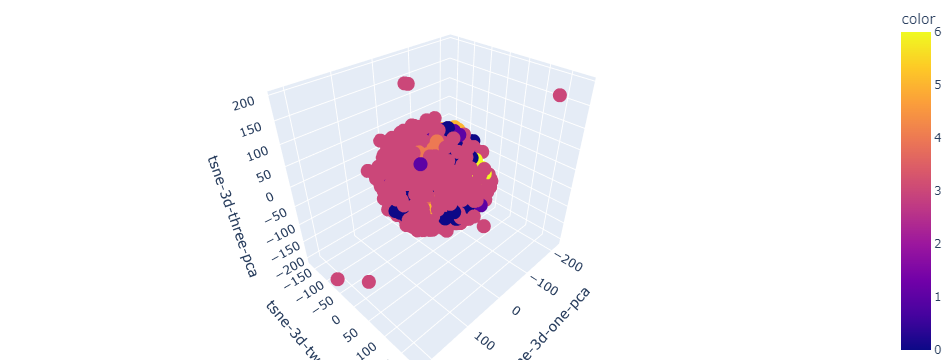

In [37]:
#
clustering_3d_function(res_sift[1], res_sift[0][0], res_sift[0][1], res_sift[0][2], 'automatic', True)


#### Confusion matrix

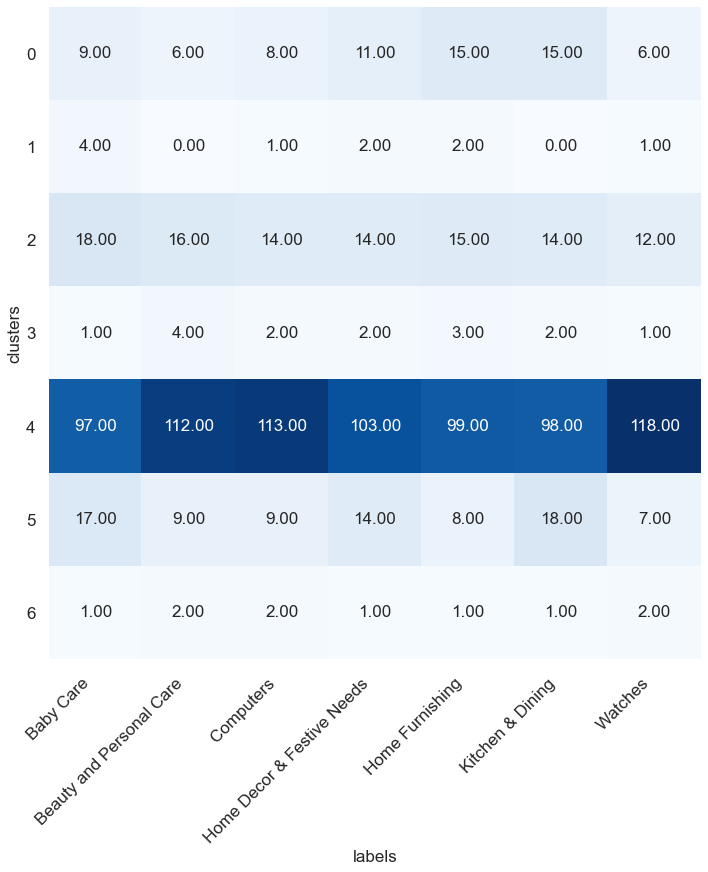

In [38]:
#
plot_confusion_matrix_function(res_sift[0][0], res_sift[0][1], "")

In [39]:
#
df_sift = res_sift[1]
df_sift['image_vectorized_sift_pca_numpy'] = res_sift[5].tolist()

#
df_export = pd.read_pickle("data/df_export.pkt")
df_export = df_export.merge(df_sift, how='inner', on='product_name')
df_export = df_export[['product_name','product_category','text_vectorized_pca_tfidf_numpy','image_vectorized_sift_pca_numpy']]
df_export.to_pickle("data/df_export.pkt")

#
output = pd.read_pickle("data/df_export.pkt")
output

,product_name,product_category,text_vectorized_pca_tfidf_numpy,image_vectorized_sift_pca_numpy
0,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,Home Furnishing,"[-0.39328820017381527, -0.06855124847576416, 0.0503748597066191, -0.038772747574730426, -0.22275...","[-0.026925361802147062, -0.0013785859698354746, 0.006035832164244858, -0.07087158943120163, -0.0..."
1,Sathiyas Cotton Bath Towel,Baby Care,"[-0.41923352015070287, 0.04122570261430237, 0.17563889778768826, -0.011490592059028939, -0.06167...","[-0.040936442399145095, -0.013830566824275557, 0.020531825523164137, -0.05191826620051139, -0.07..."
2,Eurospa Cotton Terry Face Towel Set,Baby Care,"[-0.35951278198376946, -0.02991632039884139, 0.1626705213808944, -0.018912874091898842, -0.07484...","[-0.032378393481229874, -0.03915286557420211, 0.002740555677049214, -0.03078997982605167, 0.0219..."
3,SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet,Home Furnishing,"[-0.43498126689169314, -0.08268525412436892, 0.06054554845741921, -0.19480921265645493, -0.21754...","[-0.06533038512507498, 0.06918048791429234, 0.11174137245540776, 0.014379322168116904, -0.243636..."
4,Jaipur Print Cotton Floral King sized Double Bedsheet,Home Furnishing,"[-0.39972811722106305, -0.08624820304514738, 0.08246140556013606, -0.18122184908726452, -0.18683...","[0.25581536128030263, 0.013239899789916298, -0.017388551423231802, -0.08970430635183092, 0.04085..."
...,...,...,...,...
1025,Wallmantra Medium Vinyl Stickers Sticker,Baby Care,"[0.15055093594290636, -0.11098233429107944, -0.16475431687438108, -0.11983322126065324, 0.131242...","[-0.03193830925342436, -0.05609766793617408, -0.02480518235309269, 0.007161464825537825, -0.0373..."
1026,Oren Empower Extra Large Self Adhesive Sticker,Baby Care,"[-0.2873784932063822, -0.011298566969161232, -0.011202482022532434, -0.005209732955659415, -0.08...","[-0.007865044257671858, -0.05817254484581985, -0.08006141329272995, -0.038824342283707965, 0.032..."
1027,Uberlyfe Extra Large Pigmented Polyvinyl Films (Imported) Sticker,Baby Care,"[0.13179042384599868, -0.0990254377821441, -0.14906481231453508, -0.10590457489536764, 0.1199113...","[0.3121288380003382, 0.007150916654350991, 0.0176710180058667, -0.021884316861357125, -0.0209484..."
1028,Wallmantra Medium Vinyl Sticker Sticker,Baby Care,"[0.15055093594290636, -0.11098233429107944, -0.16475431687438108, -0.11983322126065324, 0.131242...","[-0.08230512820559704, 0.2762378292915056, -0.033990740719484686, 0.05867505393662362, 0.0986302..."


#### Image samples

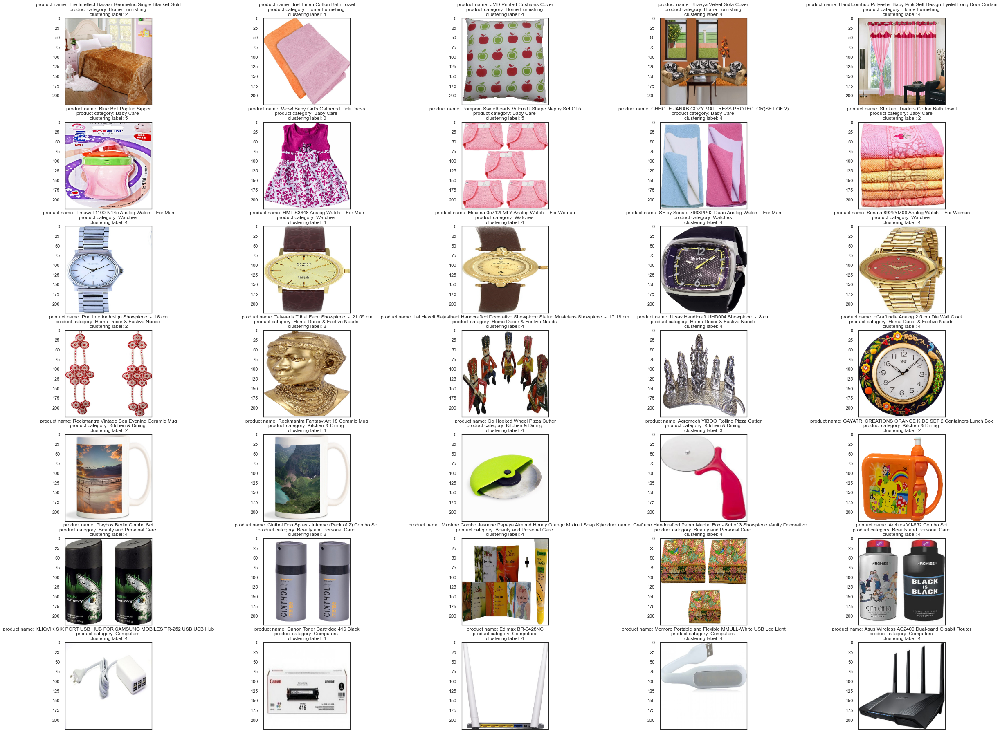

In [40]:
# product samples by product_category
image_sample_display(res_sift[1], 5, 7, 'product_category')

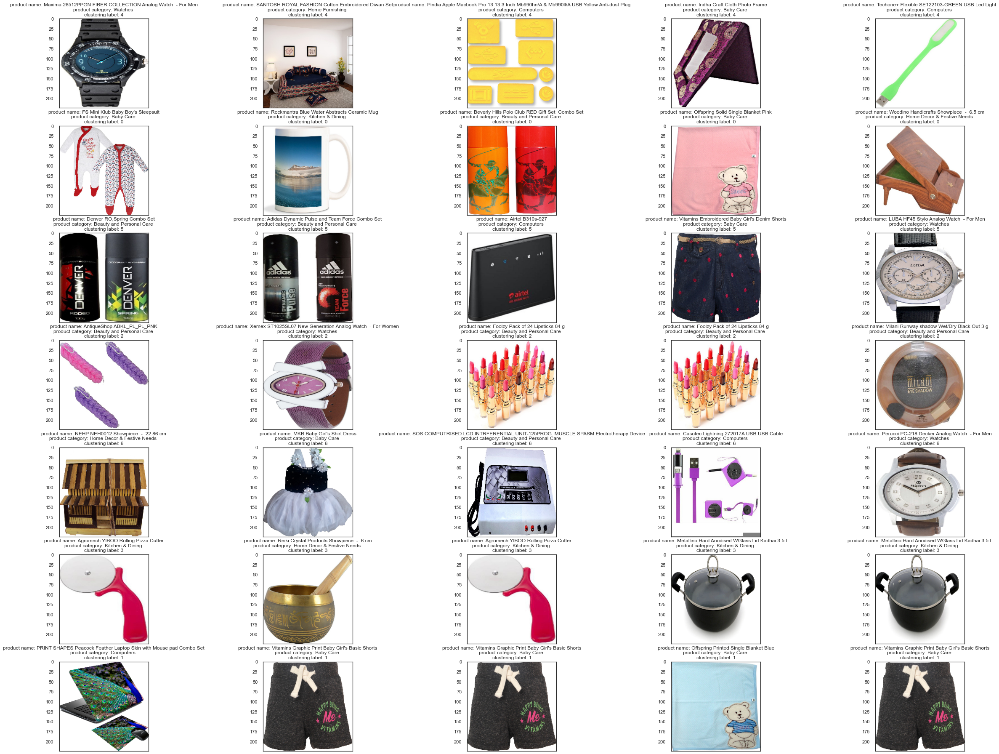

In [41]:
# product samples by product_category
image_sample_display(res_sift[1], 5, 7, 'automatic_labels')

## VGG-16

In [42]:
# import data
'''# Import and convert .csv files into pandas dataframes
df = pd.read_csv(r"detect_and_compute/df_image_preprocessed_detect.csv",
                 #sep="",
                 encoding="utf-8")'''

'# Import and convert .csv files into pandas dataframes\ndf = pd.read_csv(r"detect_and_compute/df_image_preprocessed_detect.csv",\n                 #sep="",\n                 encoding="utf-8")'

In [43]:
#
df_vgg = res_sift[1].copy()

# overview
info(df_vgg)
df_vgg.head(3)

25 columns
1030 rows
Rate of missing values in df : 0.0 %



,product_name,product_category,image,image_thumbnail,image_array,image_size,image_array_preprocessed,image_array_preprocessed_size,image_thumbnail_preprocessed,keypoints,keypoints_number,descriptors,automatic_labels,automatic_labels_pca,tsne-2d-one,tsne-2d-two,tsne-2d-one-pca,tsne-2d-two-pca,tsne-3d-one,tsne-3d-two,tsne-3d-three,tsne-3d-one-pca,tsne-3d-two-pca,tsne-3d-three-pca,image_vectorized_sift_pca_numpy
0,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,Home Furnishing,55b85ea15a1536d46b7190ad6fff8ce7.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=3600x3600 at 0x1D2689CD220>,"[[[192, 184, 173], [192, 184, 173], [193, 185, 174], [193, 185, 174], [193, 185, 174], [192, 184...","(3600, 3600, 3)","[[[146, 111, 102], [120, 123, 75], [108, 106, 106], [126, 132, 126], [131, 120, 91], [112, 123, ...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D206B66C10>,"(<KeyPoint 000001D2689CD3C0>, <KeyPoint 000001D2144FB120>, <KeyPoint 000001D2144FB2D0>, <KeyPoin...",6,"[[28.0, 10.0, 40.0, 32.0, 5.0, 6.0, 16.0, 46.0, 29.0, 13.0, 7.0, 2.0, 1.0, 54.0, 79.0, 39.0, 19....",4,3,7.871068,-3.734017,13.655262,-10.006663,-30.323992,43.903023,0.192336,14.430751,-43.888210,99.288452,"[-0.026925361802147062, -0.0013785859698354746, 0.006035832164244858, -0.07087158943120163, -0.0..."
1,Sathiyas Cotton Bath Towel,Baby Care,7b72c92c2f6c40268628ec5f14c6d590.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=2388x1293 at 0x1D2683EB340>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(1293, 2388, 3)","[[[124, 108, 103], [131, 130, 98], [101, 106, 110], [144, 93, 153], [96, 138, 123], [103, 157, 8...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D206B66BB0>,"(<KeyPoint 000001D2144FB390>, <KeyPoint 000001D2144FB570>, <KeyPoint 000001D2144FB630>, <KeyPoin...",5,"[[78.0, 33.0, 19.0, 5.0, 6.0, 11.0, 12.0, 55.0, 12.0, 16.0, 24.0, 92.0, 100.0, 52.0, 13.0, 12.0,...",4,3,15.495249,-5.391772,-3.567868,-11.387802,13.182489,25.104534,-110.543556,93.471306,-30.331024,41.116989,"[-0.040936442399145095, -0.013830566824275557, 0.020531825523164137, -0.05191826620051139, -0.07..."
2,Eurospa Cotton Terry Face Towel Set,Baby Care,64d5d4a258243731dc7bbb1eef49ad74.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=982x729 at 0x1D2683EB970>,"[[[255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255, 255], [255, 255...","(729, 982, 3)","[[[116, 144, 82], [111, 161, 86], [117, 115, 93], [149, 130, 130], [144, 127, 128], [114, 114, 1...","(224, 224, 3)",<PIL.Image.Image image mode=RGB size=224x224 at 0x1D20A197B20>,"(<KeyPoint 000001D2144FB6C0>, <KeyPoint 000001D2144FB6F0>, <KeyPoint 000001D2144FB4E0>, <KeyPoin...",7,"[[8.0, 22.0, 33.0, 20.0, 20.0, 25.0, 40.0, 22.0, 6.0, 23.0, 41.0, 40.0, 19.0, 32.0, 48.0, 5.0, 2...",4,3,-5.711586,-6.465328,0.942106,-12.494843,-8.979650,1.908262,66.371033,50.946945,-30.301544,-79.878624,"[-0.032378393481229874, -0.03915286557420211, 0.002740555677049214, -0.03078997982605167, 0.0219..."


### Implementation

In [44]:
#
my_vgg16_implementation_function()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 64)      1792      
                                                                 
 conv2d_1 (Conv2D)           (None, 224, 224, 64)      36928     
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 64)     0         
 )                                                               
                                                                 
 conv2d_2 (Conv2D)           (None, 112, 112, 128)     73856     
                                                                 
 conv2d_3 (Conv2D)           (None, 112, 112, 128)     147584    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 128)      0         
 2D)                                                    

### Classifier

In [45]:
#
pre_trained_model_as_classifier_function('dog.jpg', VGG16(), 224, 224)


Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

### Transfer Learning

In [46]:
# 1 : fine-tuning total
# (train all the network, all layers must become made trainable)

# 2 : features extraction
# (only training the new classifier)

# 3 : fine-tuning partiel
# (train new classifier and high layers)

In [47]:
#
my_model = my_custom_vgg_for_classification_function()


Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [48]:
'''#
outputs = my_custom_vgg_classification_function(df_vgg, 
                                               my_model, 
                                               'image_thumbnail', 
                                               'product_category',
                                               1,
                                               4)
 '''

"#\noutputs = my_custom_vgg_classification_function(df_vgg, \n                                               my_model, \n                                               'image_thumbnail', \n                                               'product_category',\n                                               1,\n                                               4)\n "

### Clustering

In [49]:
#
vgg_for_clustering = vgg_for_clustering_function()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

#### 2D



PCA:

(PCA) explained variance for 600 components: 0.9564794301986694



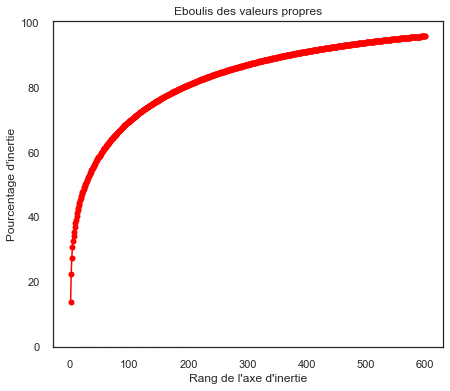



Clustering:



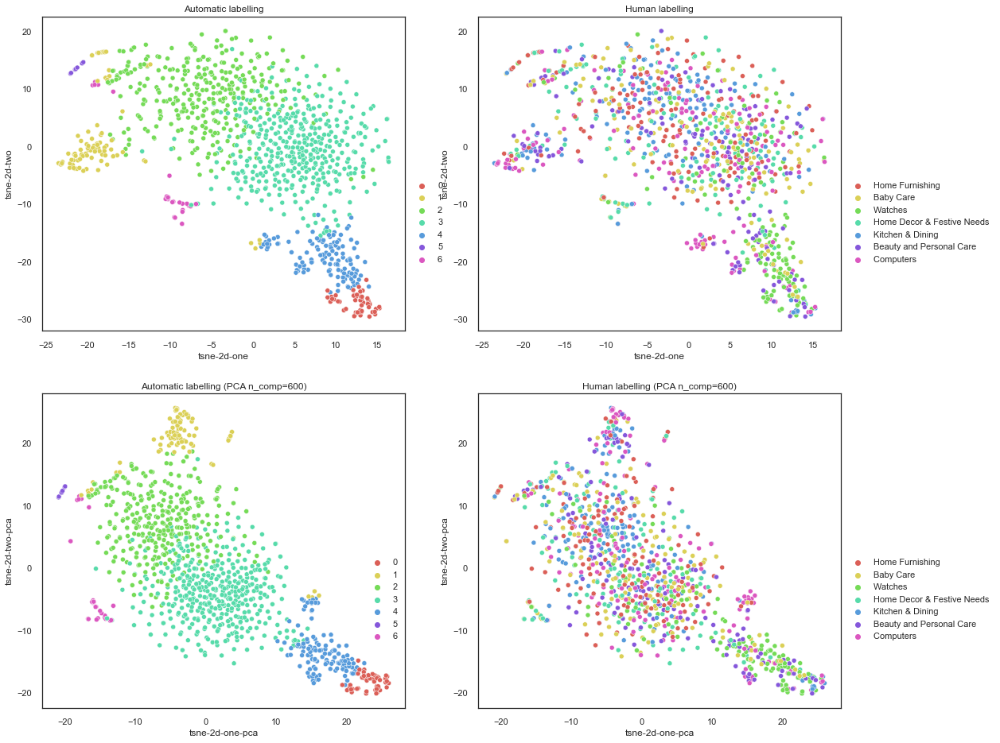


clustering stats:

ARI: 0.03208516024336536
Silhouette: 0.08283346812945105
Clustering fit time: 14.677899

clustering stats after pca:

ARI: 0.02952818786768587
Silhouette: 0.09868154240148005
Clustering fit time: 0.43384


In [50]:
#
clustering_params = {'n_clusters': 7}

#
res_vgg = vgg_clustering_function(df_vgg, 
                                  vgg_for_clustering, 
                                  'image_thumbnail_preprocessed', 
                                  'product_category', 
                                  KMeans,
                                  clustering_params,    
                                  600)


#### 3D

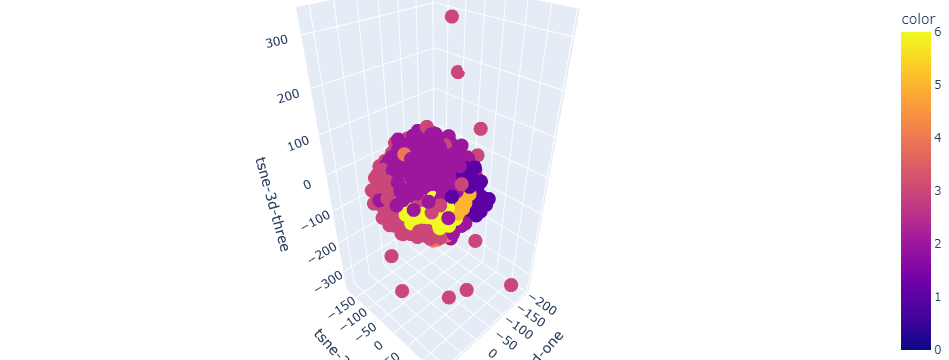

In [51]:
#
clustering_3d_function(df_vgg, res_vgg[0][0], res_vgg[0][1], res_vgg[0][2], 'automatic', False)


#### Confusion matrix

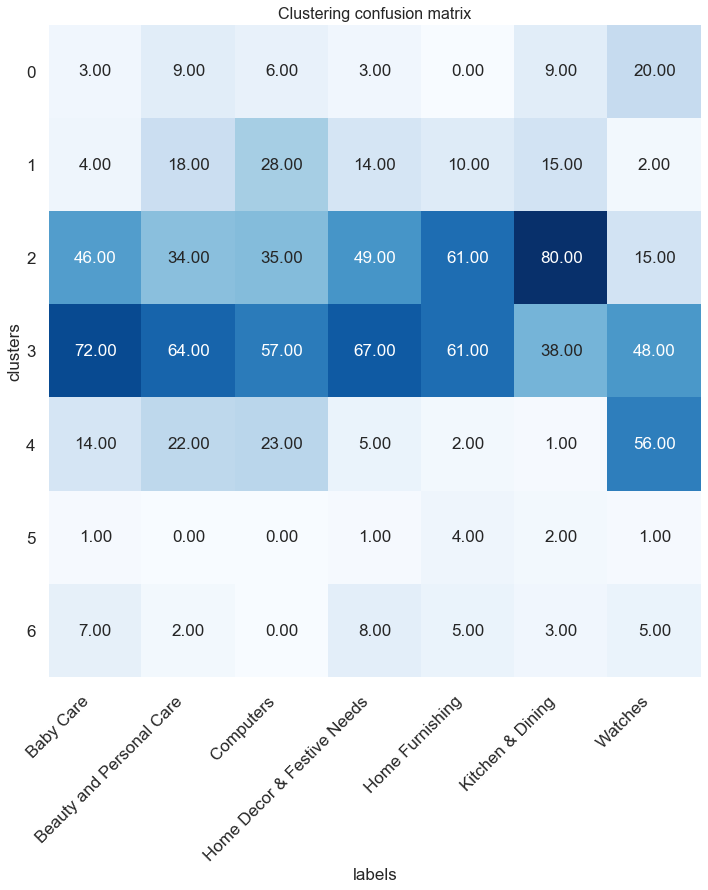

In [52]:
#
plot_confusion_matrix_function(res_vgg[0][0], res_vgg[0][1], 'Clustering confusion matrix')


#### Image samples

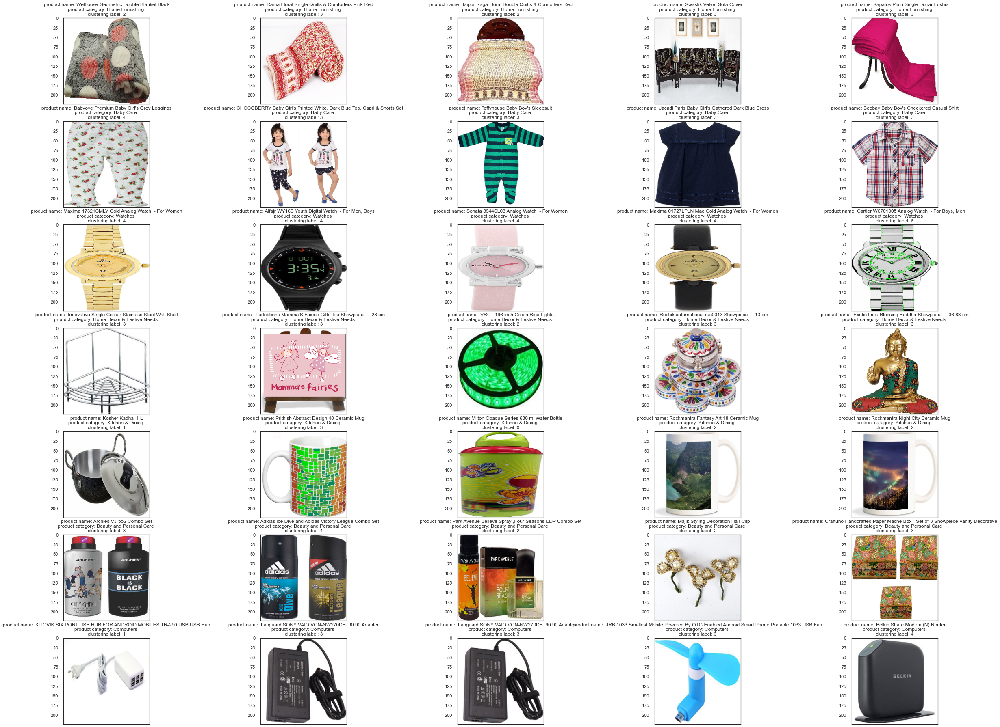

In [53]:
# product samples by product_category
image_sample_display(res_vgg[1], 5, 7, 'product_category')


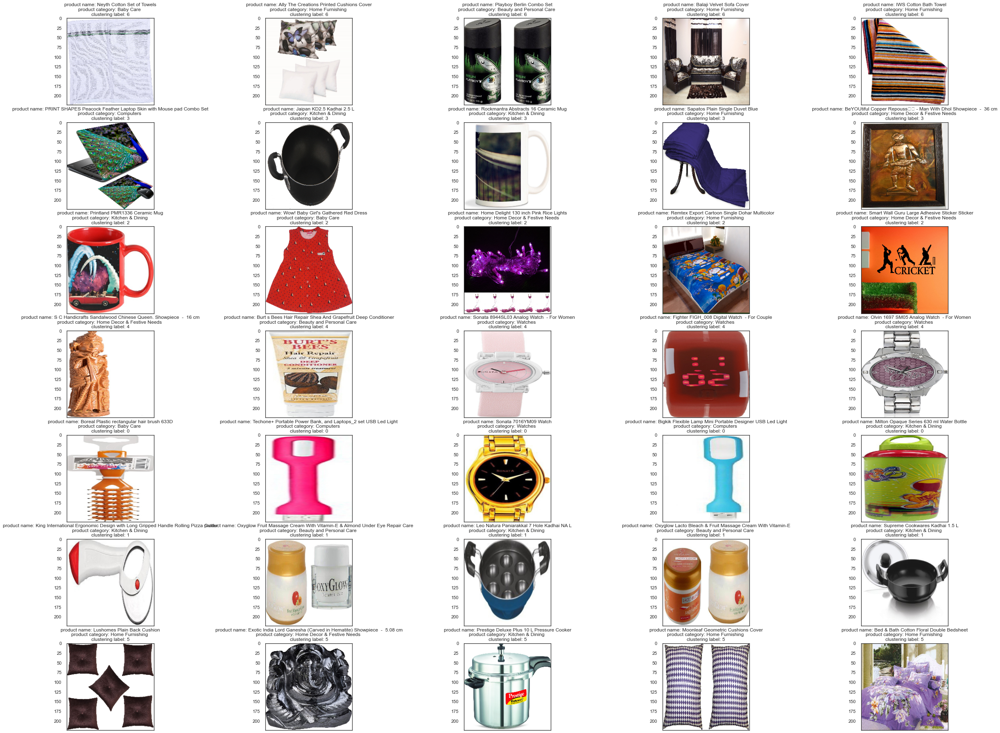

In [54]:
# product samples by automatic_labels
image_sample_display(res_vgg[1], 5, 7, 'automatic_labels')



## Stats

In [55]:
# sum_up_table_function is defined in utils.py
df_table_2 = sum_up_table_function('Silhouette', 
                                'descending',
                                sift=res_sift[2],
                                sift_pca=res_sift[3],
                                vgg=res_vgg[2],
                                vgg_pca=res_vgg[3]
                               )

df_table_2.to_pickle("data/df_table_2.pkt")

df_table_2 = df_table_2.style.highlight_min(color = 'red', axis = 0).highlight_max(color = 'green', axis = 0)
df_table_2

,ARI,Silhouette,Running time
sift,0.000941,0.164066,0.086767
sift_pca,0.002411,0.159498,0.092751
vgg_pca,0.029528,0.098682,0.433840
vgg,0.032085,0.082833,14.677899


# Export data for further use

In [56]:
#
df_export = pd.read_pickle("data/df_export.pkt")

# update with imgage data
df_export['image_vectorized_vgg_numpy'] = res_vgg[4].tolist()

#
df_export.to_pickle("data/df_export.pkt")

#
output = pd.read_pickle("data/df_export.pkt")
output

,product_name,product_category,text_vectorized_pca_tfidf_numpy,image_vectorized_sift_pca_numpy,image_vectorized_vgg_numpy
0,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,Home Furnishing,"[-0.39328820017381527, -0.06855124847576416, 0.0503748597066191, -0.038772747574730426, -0.22275...","[-0.026925361802147062, -0.0013785859698354746, 0.006035832164244858, -0.07087158943120163, -0.0...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.4581589102745056, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.559..."
1,Sathiyas Cotton Bath Towel,Baby Care,"[-0.41923352015070287, 0.04122570261430237, 0.17563889778768826, -0.011490592059028939, -0.06167...","[-0.040936442399145095, -0.013830566824275557, 0.020531825523164137, -0.05191826620051139, -0.07...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2.04391479..."
2,Eurospa Cotton Terry Face Towel Set,Baby Care,"[-0.35951278198376946, -0.02991632039884139, 0.1626705213808944, -0.018912874091898842, -0.07484...","[-0.032378393481229874, -0.03915286557420211, 0.002740555677049214, -0.03078997982605167, 0.0219...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5935195684432983, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet,Home Furnishing,"[-0.43498126689169314, -0.08268525412436892, 0.06054554845741921, -0.19480921265645493, -0.21754...","[-0.06533038512507498, 0.06918048791429234, 0.11174137245540776, 0.014379322168116904, -0.243636...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.91973686..."
4,Jaipur Print Cotton Floral King sized Double Bedsheet,Home Furnishing,"[-0.39972811722106305, -0.08624820304514738, 0.08246140556013606, -0.18122184908726452, -0.18683...","[0.25581536128030263, 0.013239899789916298, -0.017388551423231802, -0.08970430635183092, 0.04085...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.42556476..."
...,...,...,...,...,...
1025,Wallmantra Medium Vinyl Stickers Sticker,Baby Care,"[0.15055093594290636, -0.11098233429107944, -0.16475431687438108, -0.11983322126065324, 0.131242...","[-0.03193830925342436, -0.05609766793617408, -0.02480518235309269, 0.007161464825537825, -0.0373...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.98142158..."
1026,Oren Empower Extra Large Self Adhesive Sticker,Baby Care,"[-0.2873784932063822, -0.011298566969161232, -0.011202482022532434, -0.005209732955659415, -0.08...","[-0.007865044257671858, -0.05817254484581985, -0.08006141329272995, -0.038824342283707965, 0.032...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.79188287..."
1027,Uberlyfe Extra Large Pigmented Polyvinyl Films (Imported) Sticker,Baby Care,"[0.13179042384599868, -0.0990254377821441, -0.14906481231453508, -0.10590457489536764, 0.1199113...","[0.3121288380003382, 0.007150916654350991, 0.0176710180058667, -0.021884316861357125, -0.0209484...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.77325451..."
1028,Wallmantra Medium Vinyl Sticker Sticker,Baby Care,"[0.15055093594290636, -0.11098233429107944, -0.16475431687438108, -0.11983322126065324, 0.131242...","[-0.08230512820559704, 0.2762378292915056, -0.033990740719484686, 0.05867505393662362, 0.0986302...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2.74899077..."
